In [1]:
!pip install torch torchvision tqdm pytorch-fid

Defaulting to user installation because normal site-packages is not writeable


In [6]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import os

# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_gpus = torch.cuda.device_count()
print(f"Using device: {device}, Number of GPUs: {num_gpus}")

# Enable benchmark mode for faster training on fixed-size input
torch.backends.cudnn.benchmark = True

# Set seed for reproducibility (optional)
torch.manual_seed(42)

# Hyperparameters
BATCH_SIZE = 512  # A100s can handle large batches (adjust if OOM)
IMAGE_SIZE = 32    # CIFAR‑10 images are 32×32

# Transformations: Resize and normalize to [-1, +1]
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5),
                         (0.5, 0.5, 0.5)),
])

# CIFAR-10 Dataset
train_dataset = datasets.CIFAR10(
    root='./data',
    train=True,
    transform=transform,
    download=True
)

# DataLoader
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=min(os.cpu_count(), 16),  # Avoid overload; 16 is usually optimal
    pin_memory=True,
    drop_last=True,
    persistent_workers=True,
    prefetch_factor=4
)

# Sanity check
images, labels = next(iter(train_loader))
print(f"Loaded batch shape: {images.shape}, labels shape: {labels.shape}")



Using device: cuda, Number of GPUs: 2
Files already downloaded and verified
Loaded batch shape: torch.Size([512, 3, 32, 32]), labels shape: torch.Size([512])


In [7]:
import torch
import torch.nn as nn

# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device, f"({torch.cuda.device_count()} GPUs)")

# Model config
Z_DIM = 100
IMG_CHANNELS = 3
FEATURE_MAPS = 64

# Weight Initialization (DCGAN recommendation)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Generator: Z_DIM × 1 × 1 → 3 × 32 × 32
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.ConvTranspose2d(Z_DIM, FEATURE_MAPS * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(FEATURE_MAPS * 8, FEATURE_MAPS * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(FEATURE_MAPS * 4, FEATURE_MAPS * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(FEATURE_MAPS * 2, FEATURE_MAPS, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS),
            nn.ReLU(True),

            nn.ConvTranspose2d(FEATURE_MAPS, IMG_CHANNELS, 3, 1, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.net(x)

# Discriminator: 3 × 32 × 32 → scalar
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(IMG_CHANNELS, FEATURE_MAPS, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(FEATURE_MAPS, FEATURE_MAPS * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(FEATURE_MAPS * 2, FEATURE_MAPS * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURE_MAPS * 4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(FEATURE_MAPS * 4, 1, 4, 1, 0, bias=False),
        )

    def forward(self, x):
        out = self.net(x)
        return out.view(-1)

# Instantiate models
G = Generator().to(device)
D = Discriminator().to(device)

# Apply DCGAN weight initialization
G.apply(weights_init)
D.apply(weights_init)

# Use DataParallel for multi-GPU training
if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs via DataParallel")
    G = nn.DataParallel(G)
    D = nn.DataParallel(D)

# Count parameters
g_params = sum(p.numel() for p in G.parameters() if p.requires_grad)
d_params = sum(p.numel() for p in D.parameters() if p.requires_grad)
print(f"Generator parameters: {g_params:,}")
print(f"Discriminator parameters: {d_params:,}")

# AMP support hint for later training
scaler = torch.cuda.amp.GradScaler()



Using device: cuda (2 GPUs)
Using 2 GPUs via DataParallel
Generator parameters: 3,575,360
Discriminator parameters: 663,296


Loss and optimizers set up successfully.


Epoch 1/100: 100%|██████████| 97/97 [00:47<00:00,  2.02it/s, loss_D=0.521, loss_G=1.86]


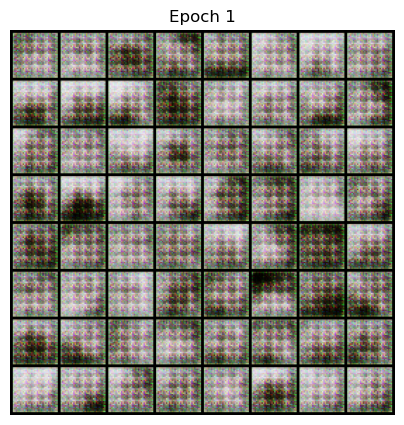

Epoch 2/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.5, loss_G=3.39]  


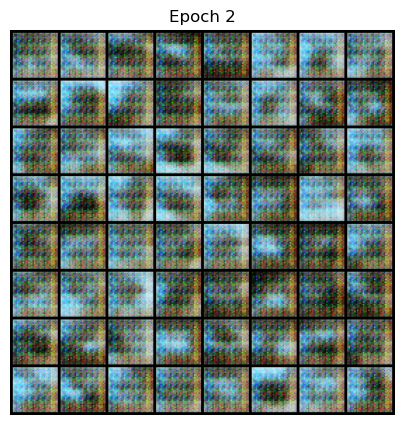

Epoch 3/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.569, loss_G=1.93]


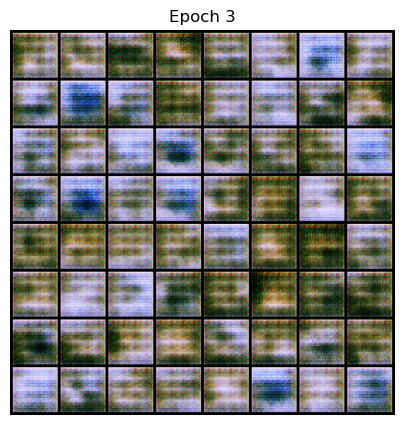

Epoch 4/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.469, loss_G=1.59]


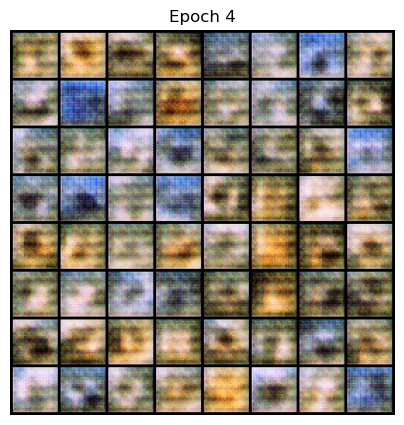

Epoch 5/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.567, loss_G=2.81]


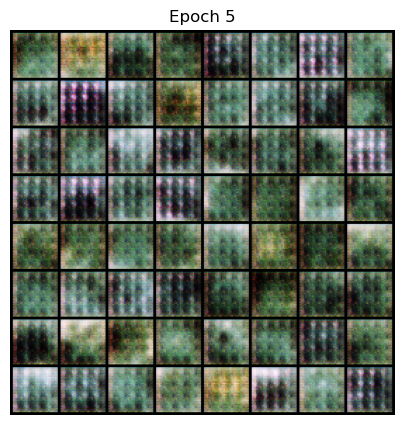

Epoch 6/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.536, loss_G=2.28] 


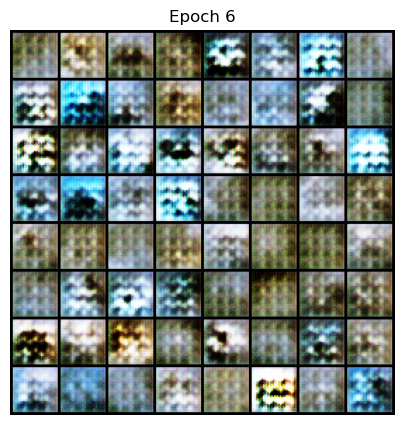

Epoch 7/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.341, loss_G=2.69]


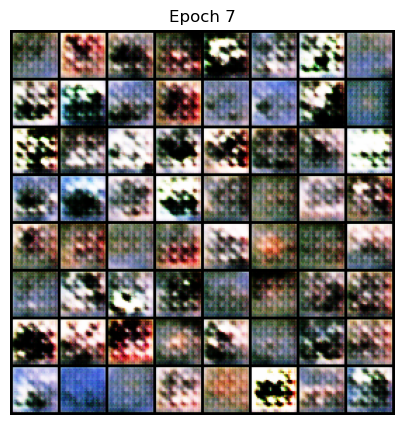

Epoch 8/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.385, loss_G=2.46]


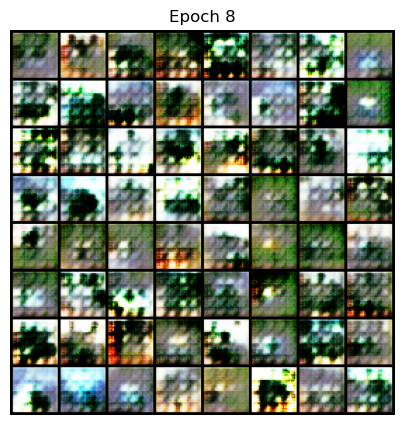

Epoch 9/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.375, loss_G=2.64]


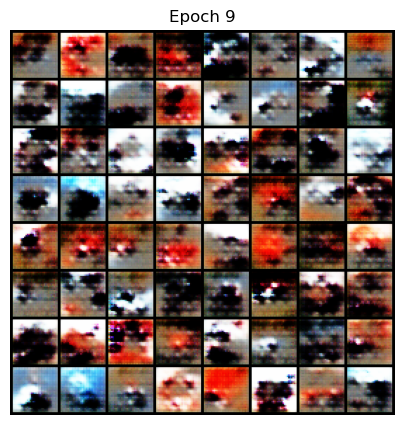

Epoch 10/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.483, loss_G=2.37]


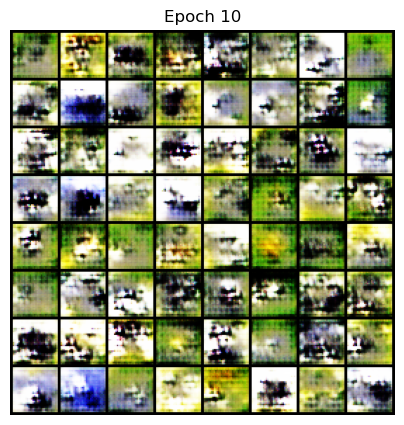

Epoch 11/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.551, loss_G=1.69]


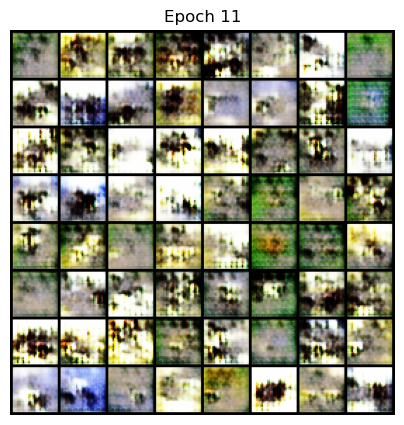

Epoch 12/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.518, loss_G=1.9]  


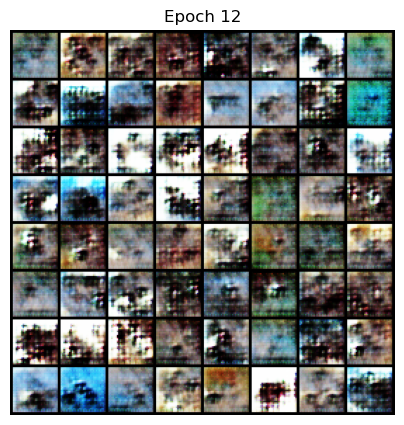

Epoch 13/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.552, loss_G=2.72]


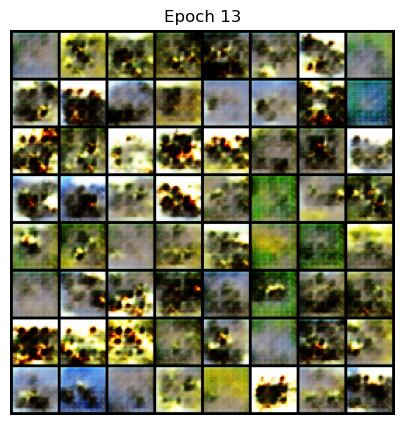

Epoch 14/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.382, loss_G=2.16]


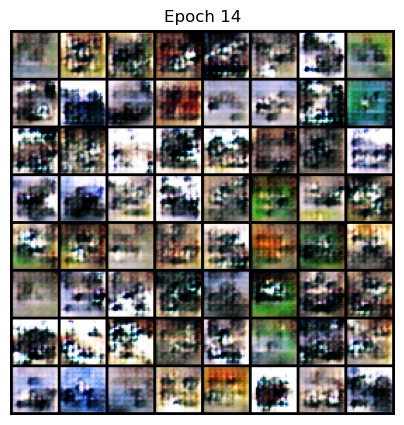

Epoch 15/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.631, loss_G=3.99] 


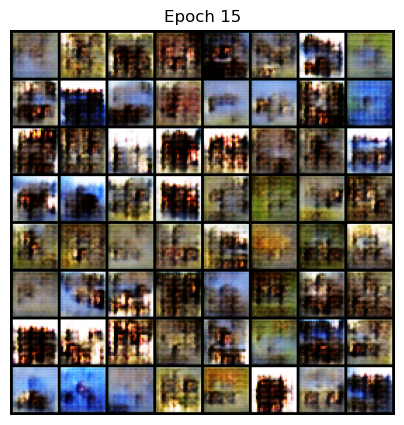

Epoch 16/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.411, loss_G=1.76] 


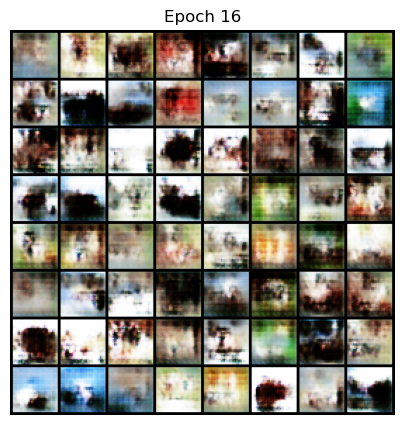

Epoch 17/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.462, loss_G=2.68] 


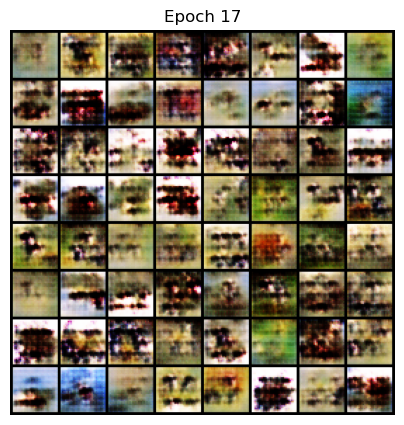

Epoch 18/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.439, loss_G=2.2]  


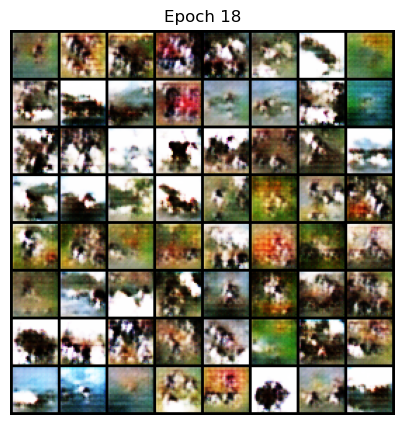

Epoch 19/100: 100%|██████████| 97/97 [00:48<00:00,  2.00it/s, loss_D=0.359, loss_G=2.31]


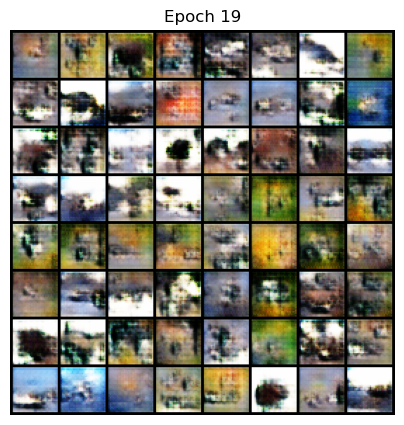

Epoch 20/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.372, loss_G=2.22] 


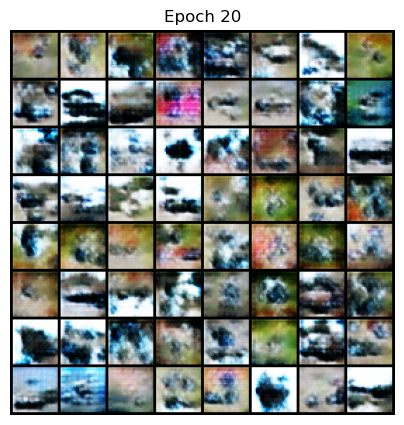

Epoch 21/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.455, loss_G=1.76] 


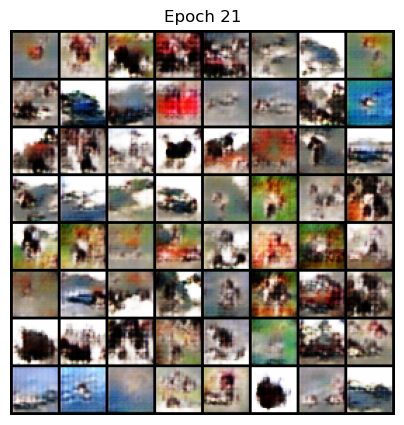

Epoch 22/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.482, loss_G=1.95]


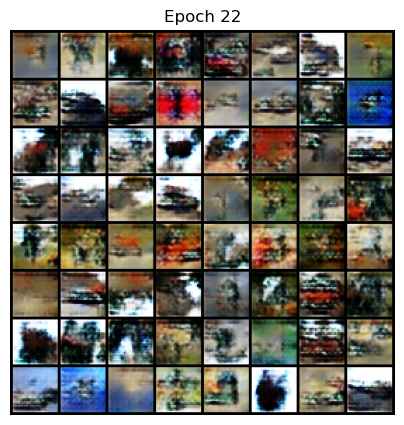

Epoch 23/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=1, loss_G=4.69]     


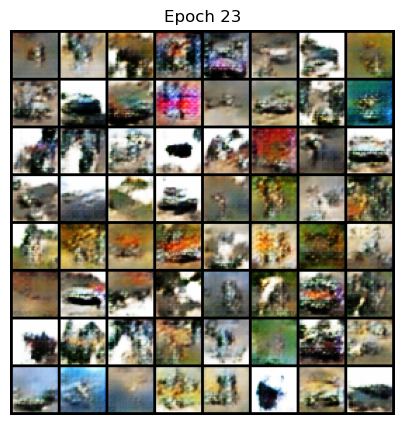

Epoch 24/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.504, loss_G=1.5] 


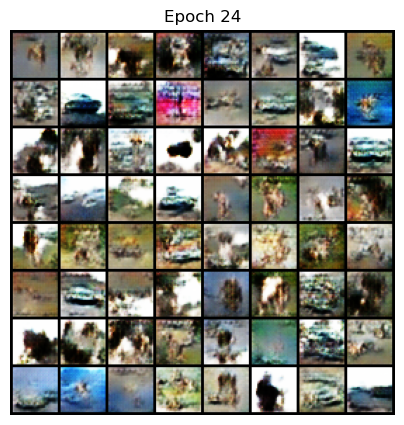

Epoch 25/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.511, loss_G=1.36] 


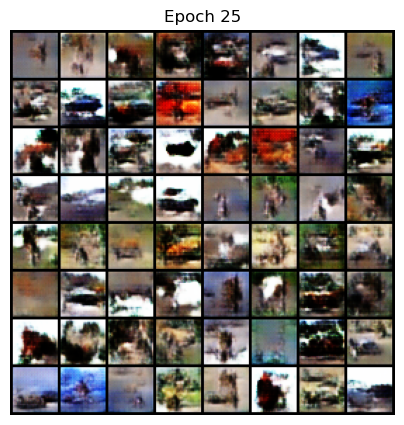

Epoch 26/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.475, loss_G=1.43]  


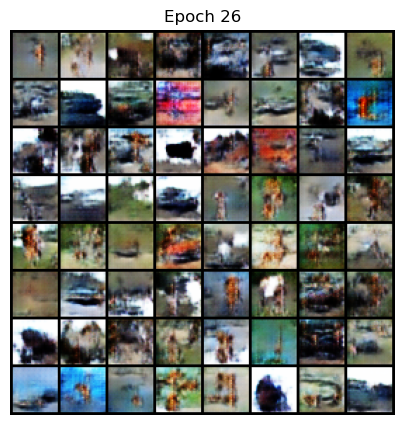

Epoch 27/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.508, loss_G=1.38] 


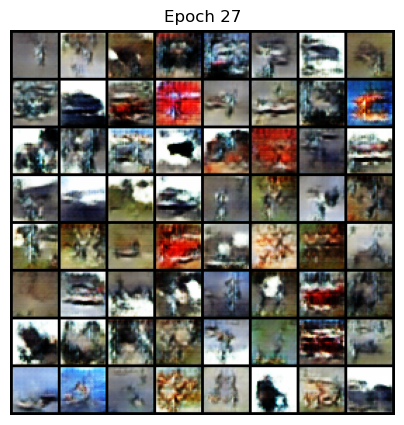

Epoch 28/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.491, loss_G=1.34] 


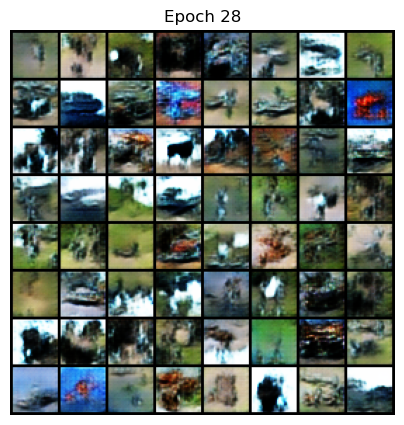

Epoch 29/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.541, loss_G=1.29]


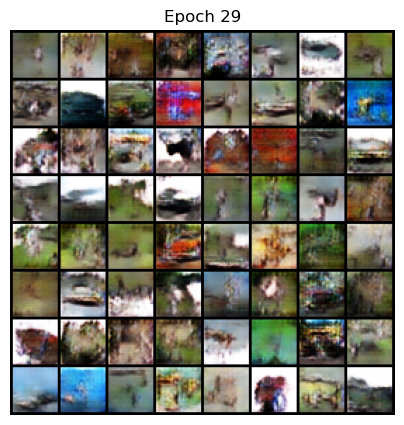

Epoch 30/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.5, loss_G=1.46]   


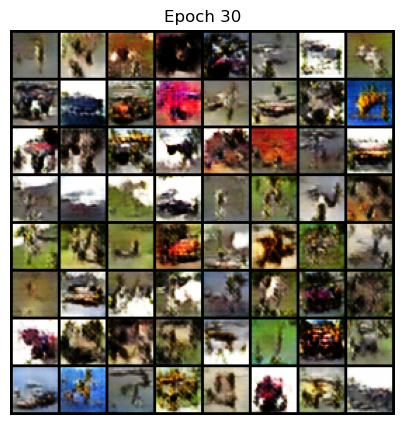

Epoch 31/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.519, loss_G=1.73]


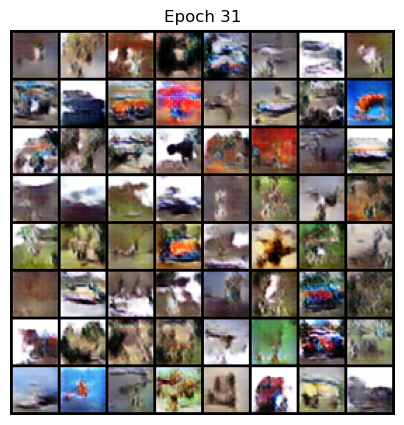

Epoch 32/100: 100%|██████████| 97/97 [00:49<00:00,  1.97it/s, loss_D=0.575, loss_G=1.18] 


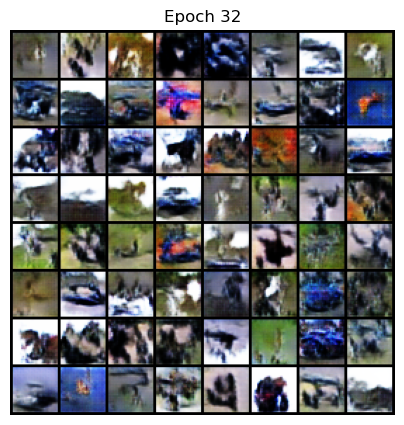

Epoch 33/100: 100%|██████████| 97/97 [00:48<00:00,  2.00it/s, loss_D=0.618, loss_G=1.34] 


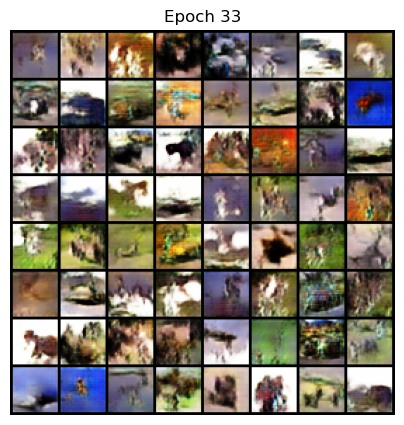

Epoch 34/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.504, loss_G=1.7]  


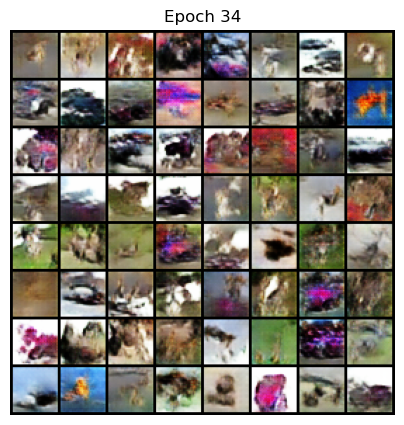

Epoch 35/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.62, loss_G=1.4]    


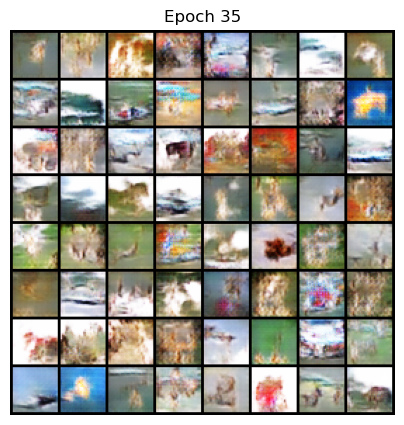

Epoch 36/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.561, loss_G=1.39] 


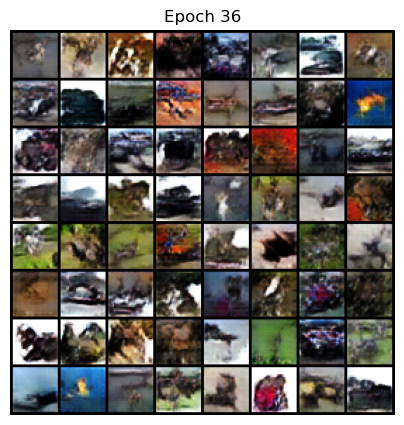

Epoch 37/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.742, loss_G=0.944]


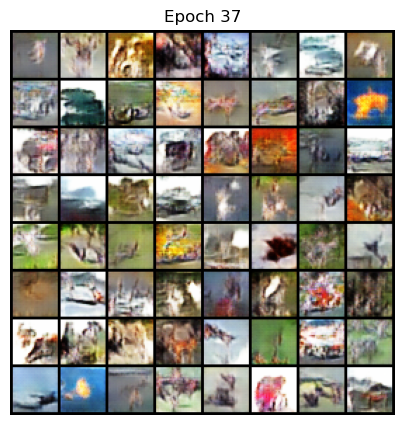

Epoch 38/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.501, loss_G=1.5]  


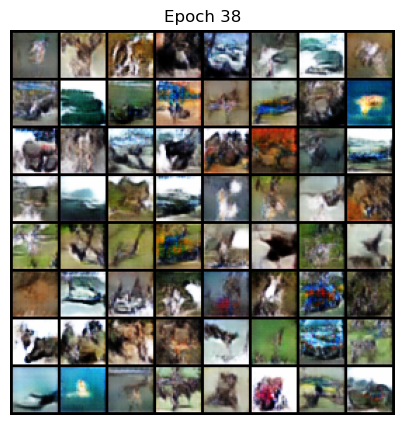

Epoch 39/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.577, loss_G=1.22] 


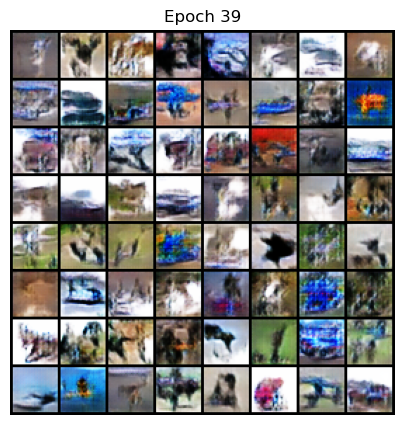

Epoch 40/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.567, loss_G=1.14] 


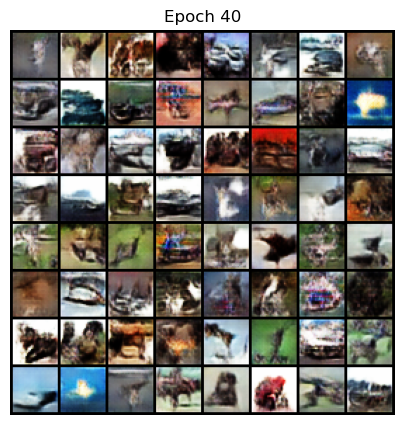

Epoch 41/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.728, loss_G=1.24] 


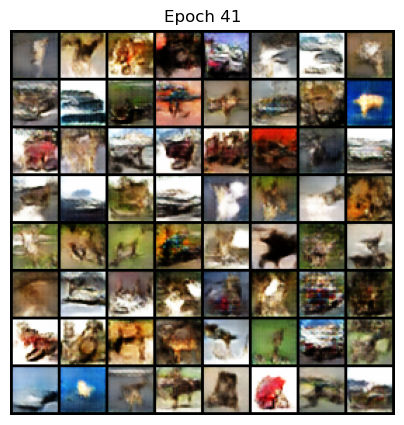

Epoch 42/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.532, loss_G=0.97] 


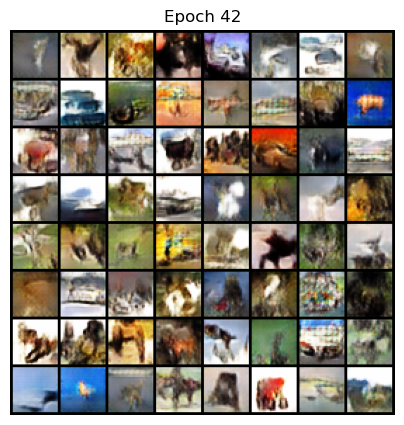

Epoch 43/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.552, loss_G=1.33] 


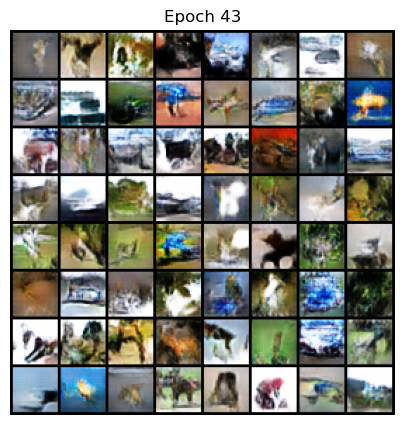

Epoch 44/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.616, loss_G=1.46] 


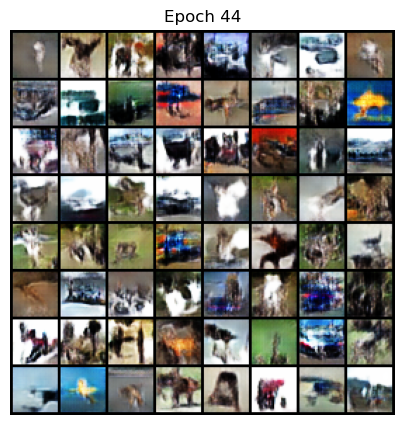

Epoch 45/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.604, loss_G=1.54] 


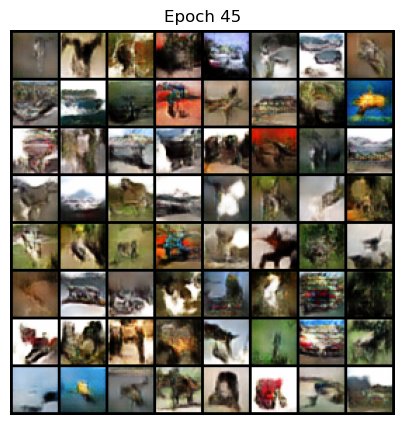

Epoch 46/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.607, loss_G=1.35] 


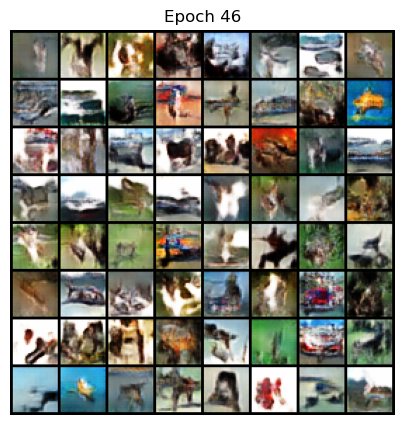

Epoch 47/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.609, loss_G=1.03] 


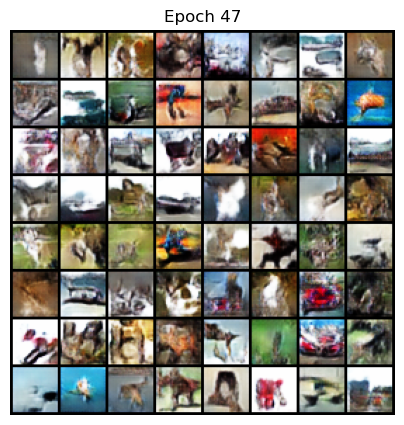

Epoch 48/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.594, loss_G=1.14] 


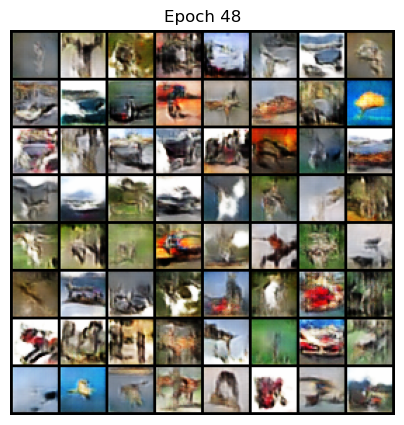

Epoch 49/100: 100%|██████████| 97/97 [00:48<00:00,  2.00it/s, loss_D=0.55, loss_G=1.18]  


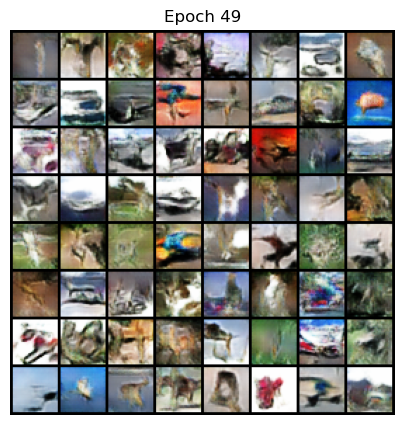

Epoch 50/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.547, loss_G=1.6]  


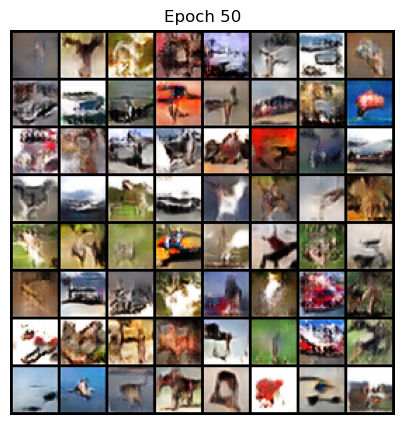

Epoch 51/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.551, loss_G=1.05] 


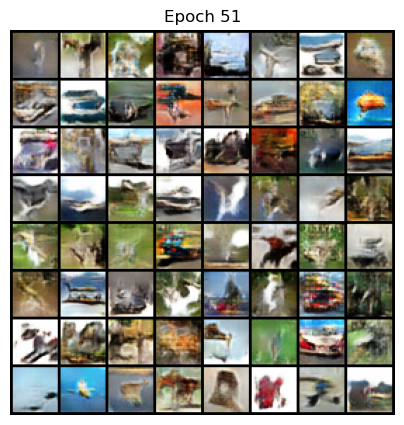

Epoch 52/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.586, loss_G=1.13] 


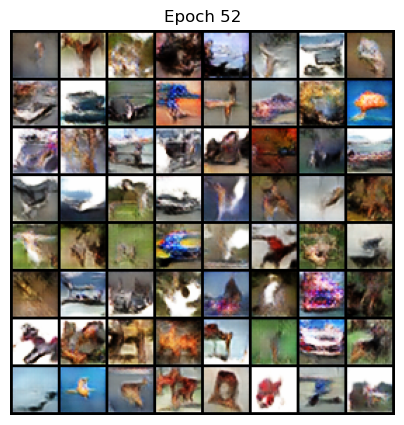

Epoch 53/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.663, loss_G=1.23] 


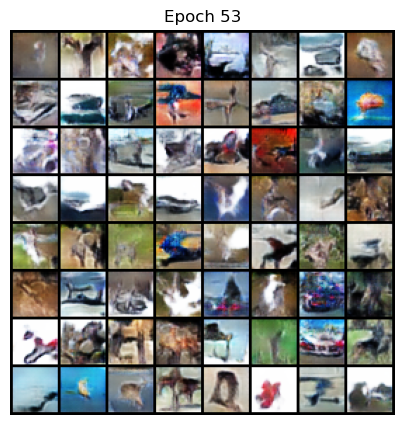

Epoch 54/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.589, loss_G=1.15] 


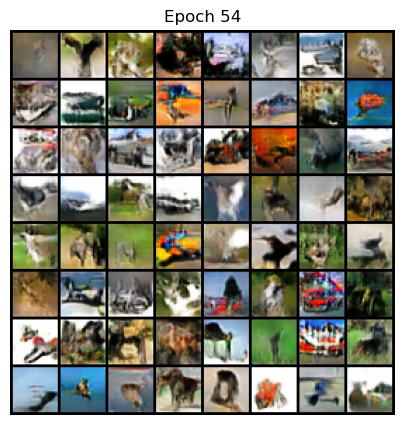

Epoch 55/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.638, loss_G=0.935]


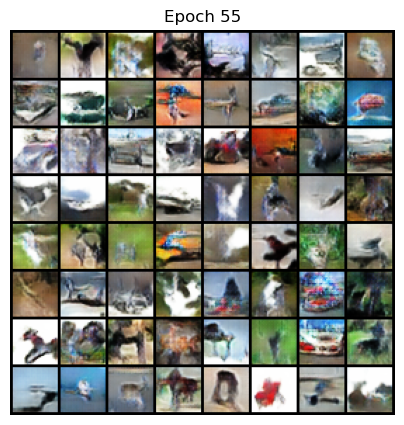

Epoch 56/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.62, loss_G=1.21]  


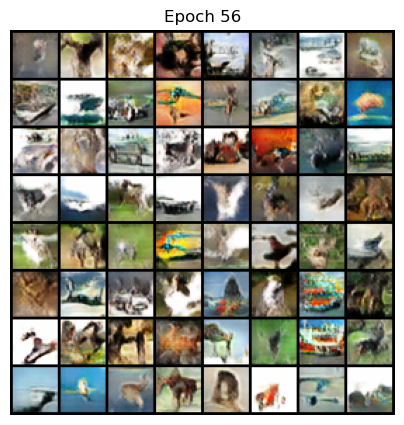

Epoch 57/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.662, loss_G=0.957]


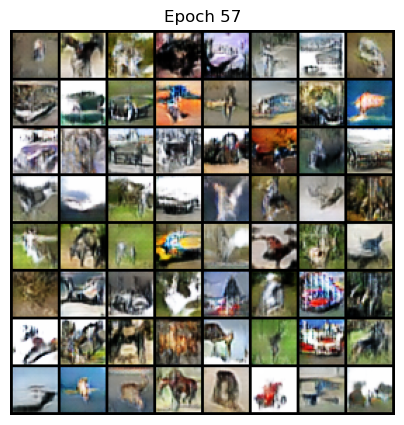

Epoch 58/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.572, loss_G=1.26] 


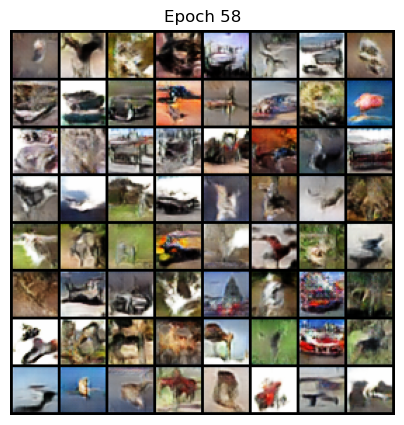

Epoch 59/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.601, loss_G=1.09] 


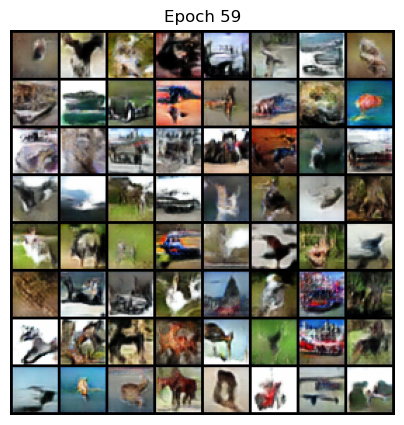

Epoch 60/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.564, loss_G=1.13] 


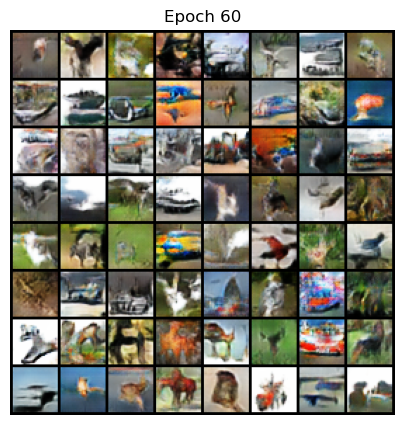

Epoch 61/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.618, loss_G=1]    


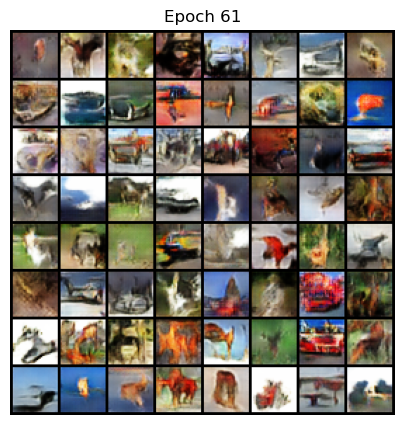

Epoch 62/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.77, loss_G=2.16]  


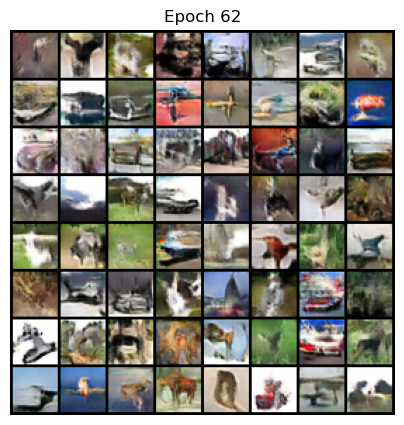

Epoch 63/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.595, loss_G=0.892]


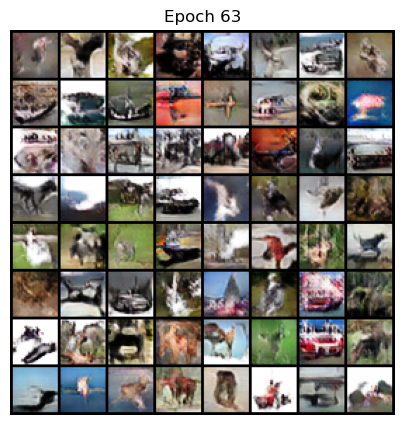

Epoch 64/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.657, loss_G=1.22] 


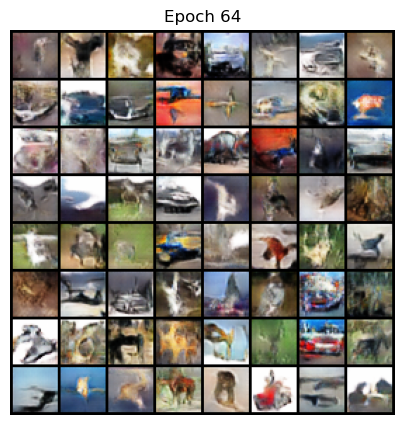

Epoch 65/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.643, loss_G=1.32] 


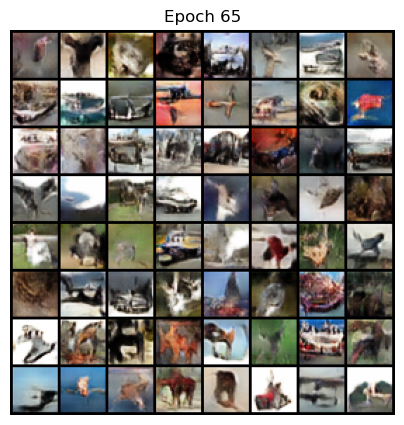

Epoch 66/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.609, loss_G=1.12] 


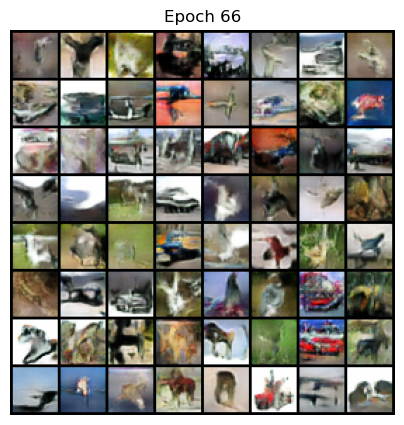

Epoch 67/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.625, loss_G=0.962]


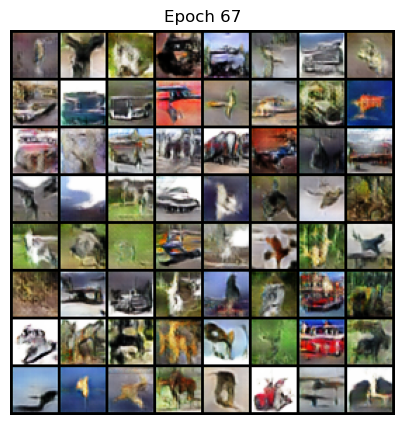

Epoch 68/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.629, loss_G=1.04] 


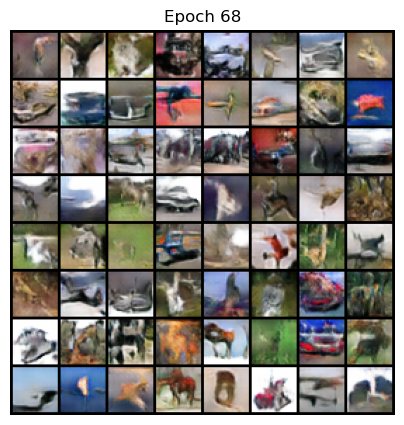

Epoch 69/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.603, loss_G=1.26] 


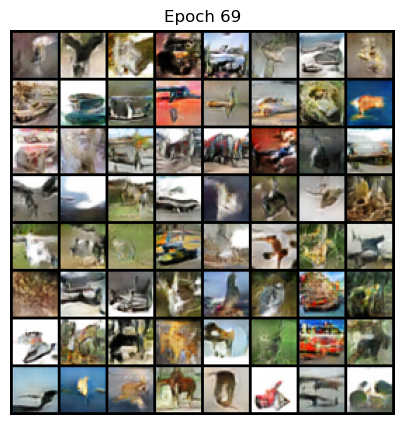

Epoch 70/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.563, loss_G=1.14] 


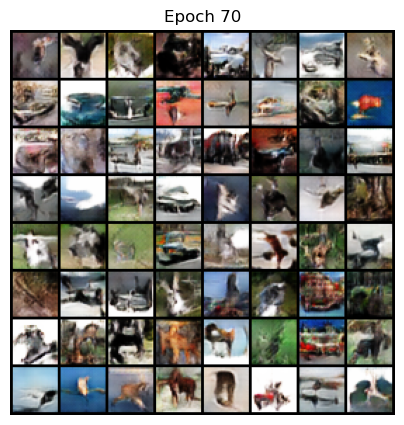

Epoch 71/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.604, loss_G=1.01] 


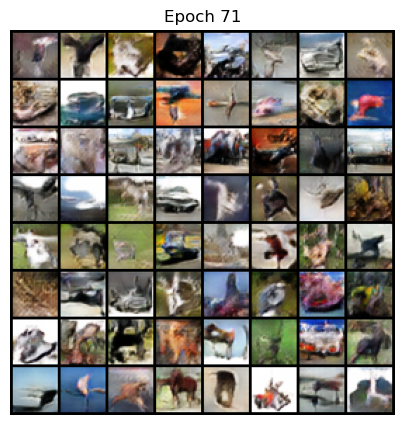

Epoch 72/100: 100%|██████████| 97/97 [00:48<00:00,  2.00it/s, loss_D=0.596, loss_G=1.03] 


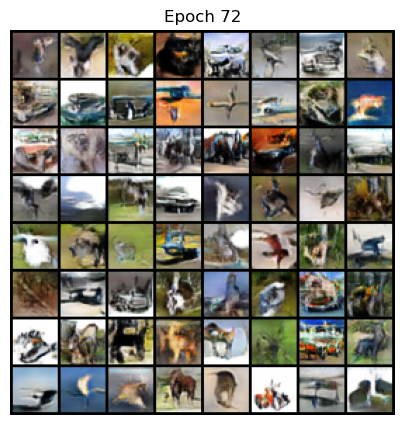

Epoch 73/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.623, loss_G=1.24] 


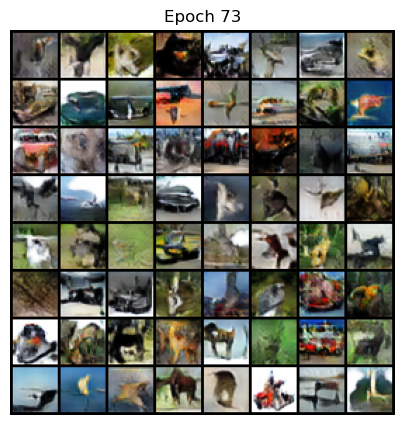

Epoch 74/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.635, loss_G=1.24] 


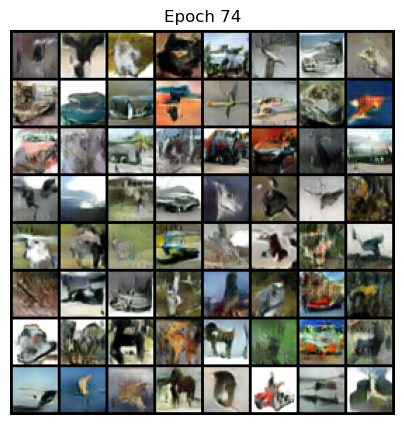

Epoch 75/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.606, loss_G=1]    


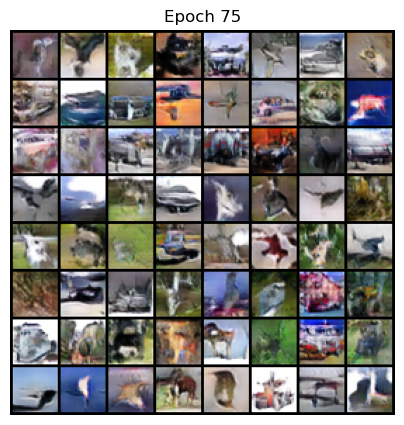

Epoch 76/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.553, loss_G=1.05] 


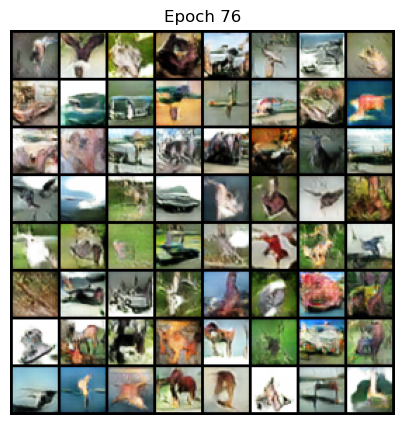

Epoch 77/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.634, loss_G=1.38] 


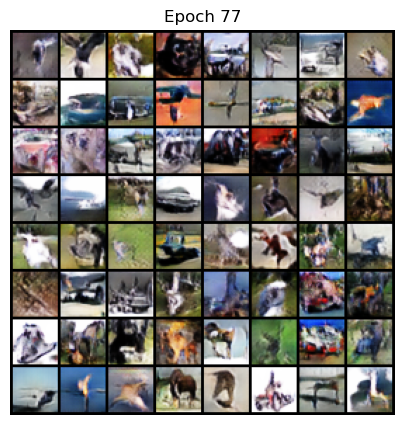

Epoch 78/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.606, loss_G=1.27] 


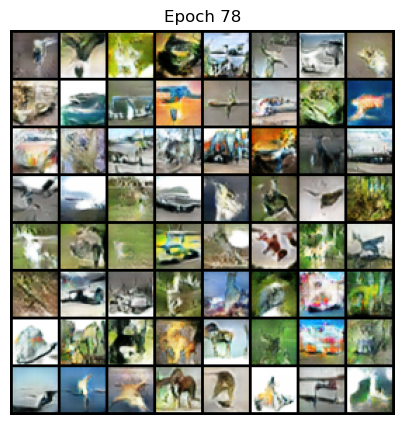

Epoch 79/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.587, loss_G=1.26] 


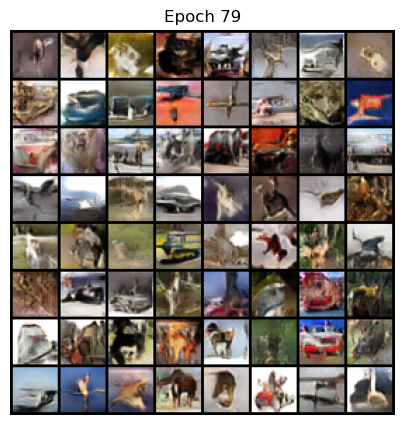

Epoch 80/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.625, loss_G=1.01] 


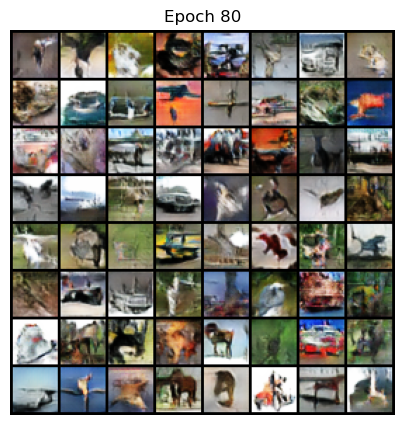

Epoch 81/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.607, loss_G=1.08] 


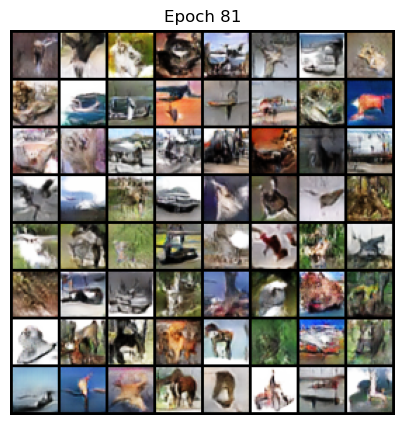

Epoch 82/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.581, loss_G=1.01] 


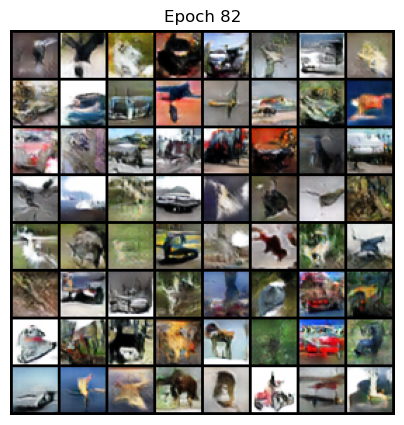

Epoch 83/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.652, loss_G=1.05] 


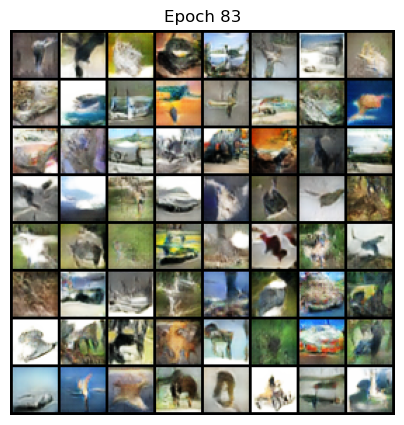

Epoch 84/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.588, loss_G=0.938]


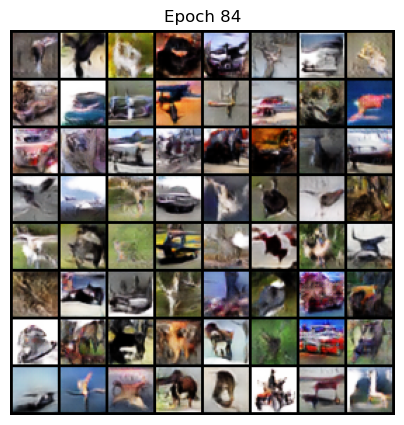

Epoch 85/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.576, loss_G=1.15] 


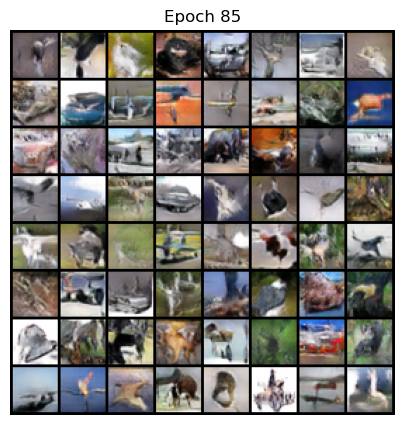

Epoch 86/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.645, loss_G=0.855]


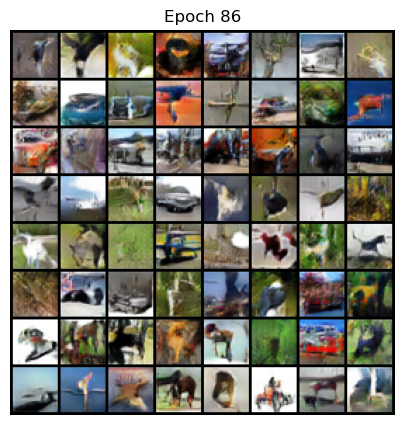

Epoch 87/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.571, loss_G=1.33] 


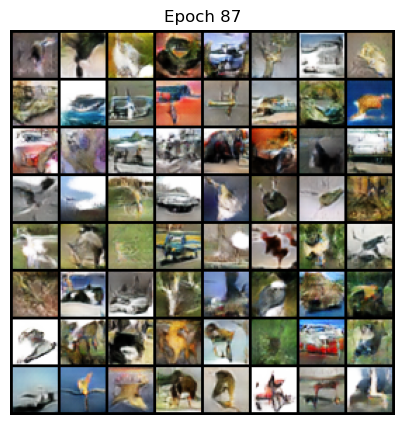

Epoch 88/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.593, loss_G=1.15] 


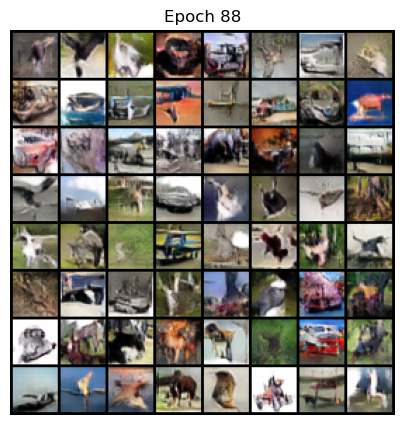

Epoch 89/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.616, loss_G=0.793]


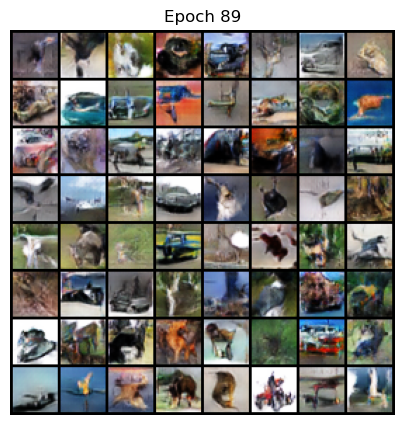

Epoch 90/100: 100%|██████████| 97/97 [00:49<00:00,  1.98it/s, loss_D=0.691, loss_G=1.89] 


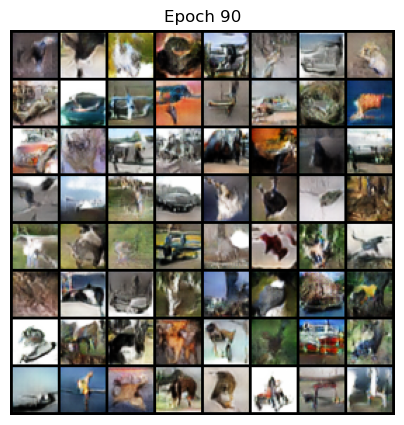

Epoch 91/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.586, loss_G=1.13] 


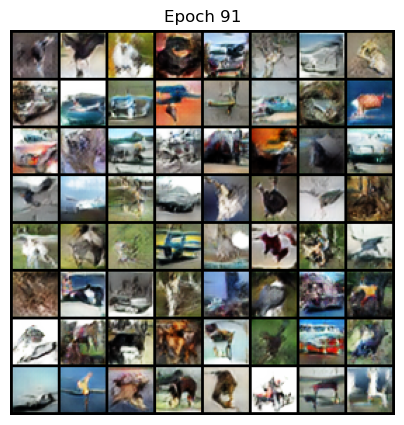

Epoch 92/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.614, loss_G=0.971]


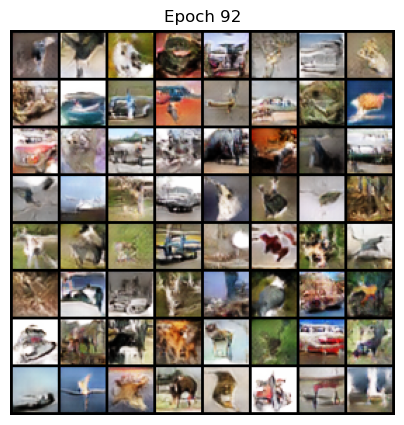

Epoch 93/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.697, loss_G=0.644]


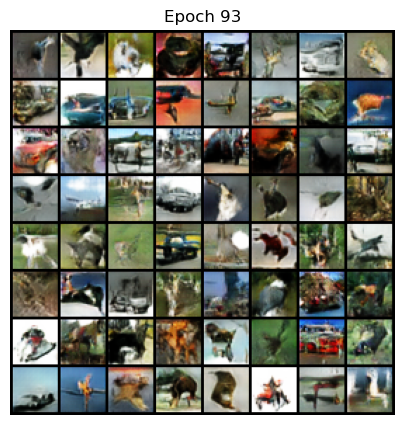

Epoch 94/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.622, loss_G=0.92] 


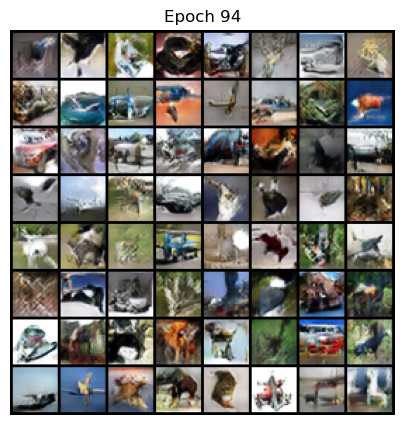

Epoch 95/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.564, loss_G=1.13] 


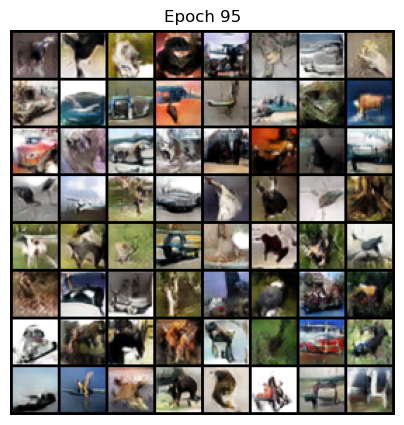

Epoch 96/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.597, loss_G=1.25] 


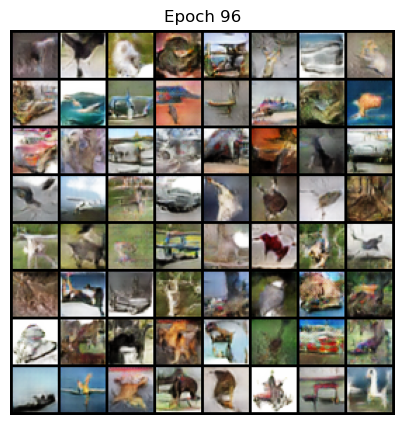

Epoch 97/100: 100%|██████████| 97/97 [00:48<00:00,  1.98it/s, loss_D=0.59, loss_G=1.02]  


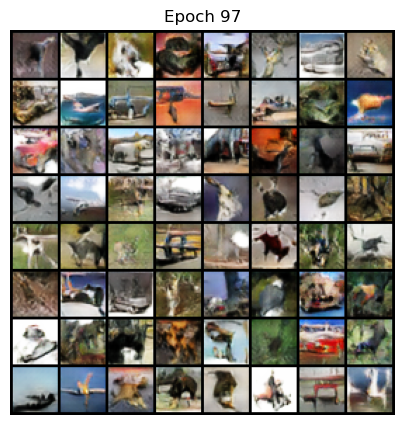

Epoch 98/100: 100%|██████████| 97/97 [00:49<00:00,  1.94it/s, loss_D=0.574, loss_G=1.16] 


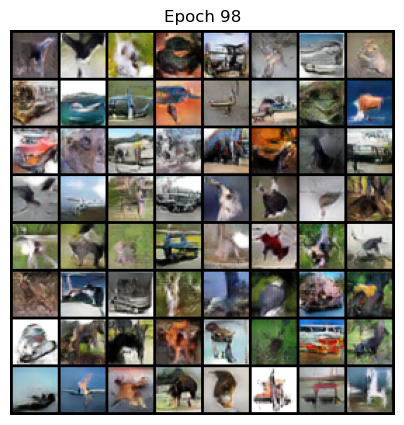

Epoch 99/100: 100%|██████████| 97/97 [00:47<00:00,  2.03it/s, loss_D=0.61, loss_G=1.13]  


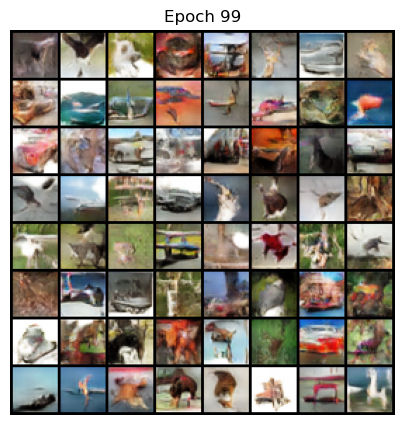

Epoch 100/100: 100%|██████████| 97/97 [00:48<00:00,  1.99it/s, loss_D=0.586, loss_G=0.965]


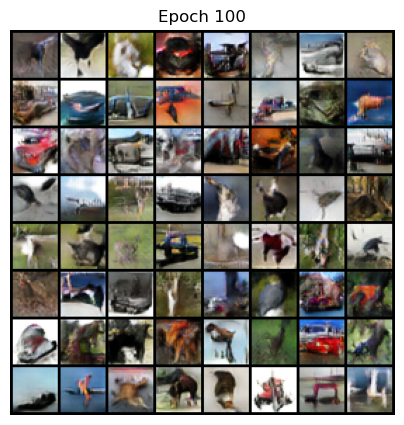

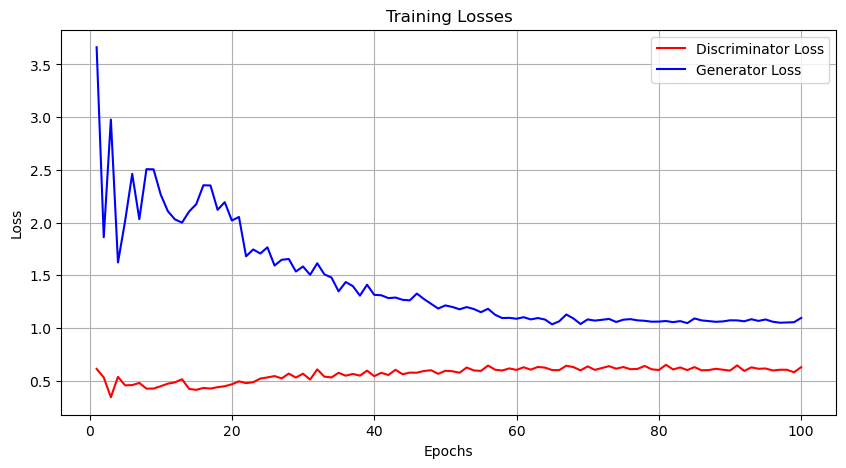

Training completed successfully!


In [8]:
import torch.optim as optim
import torch.nn as nn
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
from torchvision.utils import make_grid, save_image

# Loss: Non-saturating GAN with hinge-style modification
criterion = nn.BCEWithLogitsLoss()

# Hyperparameters
lr = 2e-4
beta1, beta2 = 0.5, 0.999

# Adam optimizers
opt_G = optim.Adam(G.parameters(), lr=lr, betas=(beta1, beta2))
opt_D = optim.Adam(D.parameters(), lr=lr, betas=(beta1, beta2))

print("Loss and optimizers set up successfully.")

# Training settings
EPOCHS = 100
sample_dir = 'samples'
os.makedirs(sample_dir, exist_ok=True)

# Fixed noise for generating sample images
fixed_noise = torch.randn(64, Z_DIM, 1, 1, device=device)

# Lists to store losses for plotting
losses_D = []
losses_G = []

for epoch in range(1, EPOCHS + 1):
    G.train()
    D.train()
    loop = tqdm(train_loader, desc=f"Epoch {epoch}/{EPOCHS}")

    epoch_loss_D = 0.0  # Track discriminator loss for the epoch
    epoch_loss_G = 0.0  # Track generator loss for the epoch

    for real_imgs, _ in loop:
        real_imgs = real_imgs.to(device)
        batch_size = real_imgs.size(0)

        ### Train Discriminator ###
        noise = torch.randn(batch_size, Z_DIM, 1, 1, device=device)
        fake_imgs = G(noise)

        real_labels = torch.ones(batch_size, device=device)
        fake_labels = torch.zeros(batch_size, device=device)

        real_logits = D(real_imgs).view(-1)
        fake_logits = D(fake_imgs.detach()).view(-1)

        loss_D_real = criterion(real_logits, real_labels)
        loss_D_fake = criterion(fake_logits, fake_labels)
        loss_D = (loss_D_real + loss_D_fake) / 2

        opt_D.zero_grad()
        loss_D.backward()
        opt_D.step()

        ### Train Generator ###
        noise = torch.randn(batch_size, Z_DIM, 1, 1, device=device)
        fake_imgs = G(noise)
        fake_logits = D(fake_imgs).view(-1)

        loss_G = criterion(fake_logits, real_labels)

        opt_G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # Update epoch losses
        epoch_loss_D += loss_D.item()
        epoch_loss_G += loss_G.item()

        loop.set_postfix(loss_D=loss_D.item(), loss_G=loss_G.item())

    # Average losses for the epoch
    avg_loss_D = epoch_loss_D / len(train_loader)
    avg_loss_G = epoch_loss_G / len(train_loader)

    # Append to lists
    losses_D.append(avg_loss_D)
    losses_G.append(avg_loss_G)

    ### Save sample grid after each epoch ###
    G.eval()
    with torch.no_grad():
        samples = G(fixed_noise).detach().cpu()
    grid = make_grid(samples, nrow=8, normalize=True)
    save_image(grid, f"{sample_dir}/epoch_{epoch}.png")

    # Plot sample images
    plt.figure(figsize=(5,5))
    plt.axis("off")
    plt.title(f"Epoch {epoch}")
    plt.imshow(grid.permute(1, 2, 0))
    plt.show()

# After training completes, plot the losses
plt.figure(figsize=(10, 5))
plt.plot(range(1, EPOCHS + 1), losses_D, label='Discriminator Loss', color='red')
plt.plot(range(1, EPOCHS + 1), losses_G, label='Generator Loss', color='blue')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Losses')
plt.legend()
plt.grid(True)
plt.show()

print("Training completed successfully!")


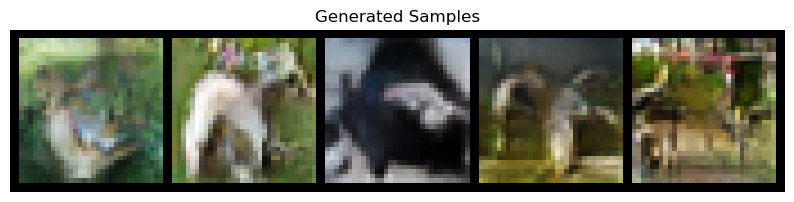

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import make_grid

def show_generated_samples(n=5):
    G.eval()
    with torch.no_grad():
        noise = torch.randn(n, Z_DIM, 1, 1, device=device)
        fake_imgs = G(noise).cpu()
    
    grid = make_grid(fake_imgs, nrow=n, normalize=True)
    plt.figure(figsize=(n * 2, 2.5))
    plt.imshow(np.transpose(grid.numpy(), (1, 2, 0)))
    plt.axis("off")
    plt.title("Generated Samples")
    plt.show()

show_generated_samples()


In [10]:
import os
from torchvision.utils import save_image

real_dir = 'fid_images/real'
os.makedirs(real_dir, exist_ok=True)

# Save real images from your training loader
G.eval()
with torch.no_grad():
    count = 0
    for real_imgs, _ in train_loader:
        for img in real_imgs:
            if count >= 5000:
                break
            save_image(img, f"{real_dir}/{count}.png", normalize=True)
            count += 1
        if count >= 5000:
            break

fake_dir = 'fid_images/fake'
os.makedirs(fake_dir, exist_ok=True)

G.eval()
with torch.no_grad():
    for i in range(5000):
        noise = torch.randn(1, Z_DIM, 1, 1, device=device)
        fake_img = G(noise).cpu()
        save_image(fake_img, f"{fake_dir}/{i}.png", normalize=True)


In [11]:
from pytorch_fid import fid_score

fid_value = fid_score.calculate_fid_given_paths(
    paths=['fid_images/real', 'fid_images/fake'],
    batch_size=50,
    device=device,
    dims=2048
)

print(f"FID score: {fid_value}")


Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /home/skadam18/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:01<00:00, 70.6MB/s]
100%|██████████| 100/100 [00:02<00:00, 38.94it/s]


FID score: 47.25332192038354
